In [ ]:
!pip install pyswarms

#**Optimización por enjambre de partículas para la función de Rastrigin en dos dimensiones**

In [ ]:
# Importar modules
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import animation, rc
from IPython.display import HTML

# Importar PySwarms
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx
from pyswarms.utils.plotters import (plot_cost_history, plot_contour, plot_surface)


In [ ]:
def rastrigin_with_args(x):
    return 20 + (x[:,0]+1)**2 + (x[:, 1]+1)**2 - 10 * (np.cos(2*np.pi*(x[:,0]+1)) + np.cos(2*np.pi*(x[:, 1]+1)))

In [ ]:
from pyswarms.single.global_best import GlobalBestPSO

# Instanciar el optimizador
x_max = 0.75 * np.ones(2)
x_min = -0.75 * x_max
bounds = (x_min, x_max)
options = {'c1': 0.2, 'c2': 0.4, 'w': 0.9}
optimizer = GlobalBestPSO(n_particles=10, dimensions=2, options=options, bounds=bounds)

# Ahora ejecutamos la optimización, pasa a=1 y b=100 como una tupla asignada a los argumentos

cost, pos = optimizer.optimize(rastrigin_with_args, 100)

2024-03-13 01:22:29,303 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.2, 'c2': 0.4, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|100/100, best_cost=1.99
2024-03-13 01:22:29,780 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 1.9899472336992403, best pos: [-0.00467024 -0.00494588]


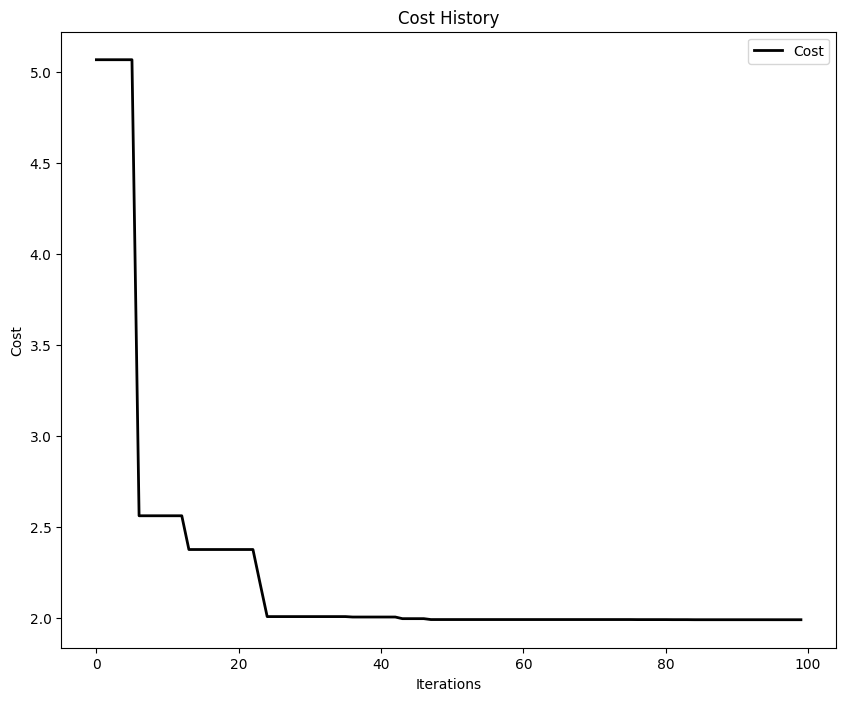

In [ ]:
plot_cost_history(cost_history=optimizer.cost_history)
plt.show()

In [ ]:
import numpy as np

# Definimos la función Rastrigin 2 dimensiones

def rastrigin_2_d(x,y):
    return 20 + (x)**2 + (y)**2 - 10 * (np.cos(2*np.pi*x) + np.cos(2*np.pi*y))

In [ ]:
import matplotlib.pyplot as plt
import imageio
import random
from IPython.display import Video
from moviepy.editor import VideoFileClip

def create_plot_2d():
    # Seteo los ejes sobre los que voy a trabajar
    plt.xlim(-2, 2)
    plt.ylim(-2, 2)

    # Generamos la nube de puntos sobre la que se generarán las curvas de nivel
    x = np.linspace(-2, 2, 100)
    y = np.linspace(-2, 2, 100)
    x, y = np.meshgrid(x, y)
    z = rastrigin_2_d(x, y)

    # Generamos las curva de nivel de la función
    plt.contour(x, y, z)

    # Etiquetas de los ejes
    plt.xlabel('$x_{1} \;  \in \; \mathbb{R}$')
    plt.ylabel('$x_{2} \;  \in \; \mathbb{R}$')

    # Solucion real
    plt.scatter(0, 0, color='blue', label='(0, 0)')

    # Mostrar el gráfico
    plt.colorbar(label='Niveles en  $z \; \in \mathbb{R}$')
    plt.title(f'Mejor solucion del grupo {1} (punto azul solución real)')
    plt.grid(True)

In [ ]:
# History of best positions
pos_history = optimizer.pos_history

create_plot_2d()

images = []
# Colors to plot points that are the best solution of each generation so that if points overlap the change is seen
colors = ['red', 'yellow', 'green', 'orange', 'pink']

for group  in range(0, len(pos_history)):

    current_group = pos_history[group]

    for position in range(0,len(current_group)):
        # Se generan las etiquetas de cada frame del video y su respectiva generación
        plt.title(f'Mejor solucion del grupo {group+1} (punto azul solución real)')

        # Graficar la mejor solución de cada generación
        plt.scatter(current_group[position][0], current_group[position][1], color = colors[random.randint(0, 4)])

        # Se guarda cada frame como imagen para luego usar las imagenes guardadas para generar el video

    plt.savefig(f'generation_{group}.png')

        # Se agrega la imagen a la lista de imagenes para luego generar el gif
    images.append(imageio.imread(f'generation_{group}.png'))
    plt.clf()
    # Seteo los ejes sobre los que voy a trabajar
    create_plot_2d()

# Se genera el gif a partir de la lista de imagenes y se guarda en el sistema de archivos
imageio.mimsave('rosenbrock_contour.gif', images, fps=1000)

# Para no mostrar la figura actual aún
plt.close()

gif_path = 'rosenbrock_contour.gif'

# Convertir GIF a video
clip = VideoFileClip(gif_path)
video_path = 'output.mp4'
clip.write_videofile(video_path, fps=1000, logger=None)

# Mostrar el video
Video(video_path, embed=True)


2024-03-13 01:34:50,618 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-13 01:34:50,938 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-13 01:34:51,504 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-13 01:34:52,465 - py.warnings - WARNING - <ipython-input-20-22a6ffa67423>:26: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(f'generation_{group}.png'))



#**Optimización por enjambre de partículas para la función de Rastrigin en tres dimensiones**

In [ ]:
# Función de Rastrigin en 3 dimensiones
def rastrigin_3d(x):
    A = 10
    n = 3
    f = A*n + ((x[:, 0])**2 - A * np.cos(2 * np.pi * (x[:, 0]))) + ((x[:, 1])**2 - A * np.cos(2 * np.pi * (x[:, 1]))) + ((x[:, 2])**2 - A * np.cos(2 * np.pi * (x[:, 2])))
    return f

In [ ]:
# instantiate the optimizer
x_max = 0.75 * np.ones(3)
x_min = -0.75 * x_max
bounds = (x_min, x_max)
options = {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
optimizer = GlobalBestPSO(n_particles=10, dimensions=3, options=options, bounds=bounds)

# now run the optimization, pass a=1 and b=100 as a tuple assigned to args

cost, pos = optimizer.optimize(rastrigin_3d, 250)

2024-03-13 01:44:37,777 - pyswarms.single.global_best - INFO - Optimize for 250 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|250/250, best_cost=6.08e-10
2024-03-13 01:44:38,583 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 6.084359682745344e-10, best pos: [6.97924551e-07 1.57533229e-06 3.13147666e-07]


Graficaremos las curvas de nivel de la función con respecto X1,X3

In [ ]:
# Función de Rastrigin en 3 dimensiones con respecto a y,z
def rastrigin_3_dim_y_z(y, z):
    A = 10
    n = 3
    return A*n + (0 - A * np.cos(2 * np.pi * 0)) + (y**2 - A * np.cos(2 * np.pi * y)) + (z**2 - A * np.cos(2 * np.pi * z))

# Función de Rastrigin en 3 dimensiones con respecto a x,z
def rastrigin_3_dim_x_z(x, z):
    A = 10
    n = 3
    return A*n + (x**2 - A * np.cos(2 * np.pi * x)) + (0 - A * np.cos(2 * np.pi * 0)) + (z**2 - A * np.cos(2 * np.pi * z))

In [ ]:
def create_plot_3d_x_z():
    # Seteo los ejes sobre los que voy a trabajar
    plt.xlim(-2, 2)
    plt.ylim(-2, 2)

    # Generamos la nube de puntos sobre la que se generarán las curvas de nivel
    x = np.linspace(-2, 2, 100)
    z = np.linspace(-2, 2, 100)
    x, z = np.meshgrid(x, z)
    w = rastrigin_3_dim_x_z(x, z)

    # Generamos las curva de nivel de la función
    plt.contour(x, z, w)

    # Etiquetas de los ejes
    plt.xlabel('$x_{1} \;  \in \; \mathbb{R}$')
    plt.ylabel('$x_{3} \;  \in \; \mathbb{R}$')

    # Solucion real
    plt.scatter(0, 0, color='blue', label='(0, 0)')


    # Mostrar el gráfico
    plt.colorbar(label='Niveles en  $z \; \in \mathbb{R}$')
    plt.title(f'Mejor solucion del grupo {1} (punto azul solución real)')
    plt.grid(True)

In [ ]:
# History of best positions
pos_history = optimizer.pos_history

create_plot_3d_x_z()

images = []
# Colors to plot points that are the best solution of each generation so that if points overlap the change is seen
colors = ['red', 'yellow', 'green', 'orange', 'pink']

for group  in range(0, len(pos_history)):

    current_group = pos_history[group]

    for position in range(0,len(current_group)):
        # Se generan las etiquetas de cada frame del video y su respectiva generación
        plt.title(f'Mejor solucion del grupo {group+1} (punto azul solución real)')

        # Graficar la mejor solución de cada generación
        plt.scatter(current_group[position][0], current_group[position][1], color = colors[random.randint(0, 4)])

        # Se guarda cada frame como imagen para luego usar las imagenes guardadas para generar el video

    plt.savefig(f'generation_{group}.png')

        # Se agrega la imagen a la lista de imagenes para luego generar el gif
    images.append(imageio.imread(f'generation_{group}.png'))
    plt.clf()
    # Seteo los ejes sobre los que voy a trabajar
    create_plot_3d_x_z()

# Se genera el gif a partir de la lista de imagenes y se guarda en el sistema de archivos
imageio.mimsave('rosenbrock_contour.gif', images, fps=1000)

# Para no mostrar la figura actual aún
plt.close()

gif_path = 'rosenbrock_contour.gif'

# Convertir GIF a video
clip = VideoFileClip(gif_path)
video_path = 'output.mp4'
clip.write_videofile(video_path, fps=1000, logger=None)

# Mostrar el video
Video(video_path, embed=True)


2024-03-13 02:02:54,900 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-13 02:02:55,049 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-13 02:02:55,174 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-13 02:02:55,472 - py.warnings - WARNING - <ipython-input-31-aee97756c98c>:26: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(f'generation_{group}.png'))



Graficaremos las curvas de nivel de la función con respecto X2,X3

In [ ]:
def create_plot_3d_y_z():
    # Seteo los ejes sobre los que voy a trabajar
    plt.xlim(-2, 2)
    plt.ylim(-2, 2)

    # Generamos la nube de puntos sobre la que se generarán las curvas de nivel
    y = np.linspace(-2, 2, 100)
    z = np.linspace(-2, 2, 100)
    y, z = np.meshgrid(y, z)
    w = rastrigin_3_dim_y_z(y, z)

    # Generamos las curva de nivel de la función
    plt.contour(y, z, w)

    # Etiquetas de los ejes
    plt.xlabel('$x_{1} \;  \in \; \mathbb{R}$')
    plt.ylabel('$x_{3} \;  \in \; \mathbb{R}$')

    # Solucion real
    plt.scatter(0, 0, color='blue', label='(0, 0)')

    # Mostrar el gráfico
    plt.colorbar(label='Niveles en  $z \; \in \mathbb{R}$')
    plt.title(f'Mejor solucion del grupo {1} (punto azul solución real)')
    plt.grid(True)

In [ ]:
# History of best positions
pos_history = optimizer.pos_history

create_plot_3d_y_z()

images = []
# Colors to plot points that are the best solution of each generation so that if points overlap the change is seen
colors = ['red', 'yellow', 'green', 'orange', 'pink']

for group  in range(0, len(pos_history)):

    current_group = pos_history[group]

    for position in range(0,len(current_group)):
        # Se geeneran las etiquetas de cada frame del video y su respectiva generación
        plt.title(f'Mejor solucion del grupo {group+1} (punto azul solución real)')

        # Graficar la mejor solución de cada generación
        plt.scatter(current_group[position][0], current_group[position][1], color = colors[random.randint(0, 4)])

        # Se guarda cada frame como imagen para luego usar las imagenes guardadas para generar el video

    plt.savefig(f'generation_{group}.png')

        # Se agrega la imagen a la lista de imagenes para luego generar el gif
    images.append(imageio.imread(f'generation_{group}.png'))
    plt.clf()
    # Seteo los ejes sobre los que voy a trabajar
    create_plot_3d_y_z()

# Se genera el gif a partir de la lista de imagenes y se guarda en el sistema de archivos
imageio.mimsave('rosenbrock_contour.gif', images, fps=1000)

# Para no mostrar la figura actual aún
plt.close()

gif_path = 'rosenbrock_contour.gif'

# Convertir GIF a video
clip = VideoFileClip(gif_path)
video_path = 'output.mp4'
clip.write_videofile(video_path, fps=1000, logger=None)

# Mostrar el video
Video(video_path, embed=True)


2024-03-13 02:16:09,136 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-13 02:16:09,344 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-13 02:16:09,570 - matplotlib.mathtext - INFO - Substituting symbol R from STIXGeneral
2024-03-13 02:16:09,862 - py.warnings - WARNING - <ipython-input-35-f2fc272ad1e0>:26: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(f'generation_{group}.png'))

